# Capstone Project - The Battle of the Neighborhoods (Week 2) #
## Applied Data Science Capstone by IBM/Coursera ##
### Fernando Tauscheck ###

## Table of contents
1. [Introduction: Business Problem](#introduction)<br>
2. [Data](#data)<br>
 2.1 [Geographic Data:](#data_geolocated)<br>

## 1. Introduction: Business Problem <a name="introduction"></a>

What define a success of an comercial business? Is location an important factor?

In this project we will try to understand how the location affects an business. Althrough the analysis can, in theory, be replicated for any type of business, we will focus on stakeholders interested in opening a **bakery** in Curitiba, Brazil.

Since there are lots of bakerys in Curitiba we will try to detect **the geographic and social characteristics of the existing bakeries and try to classify the best unexplored points with these characteristics.**

As result, we will try to provide to our stakeholders a list of the best possibles location to open a bakery 

## 2. Data: <a name="data"></a>


Some factors will have influence in our decission:
* number of existing bakerys in the neighborhood (or some correlated store)
* Socioeconomic data of the neighborhoods of Curitiba (Per capta income, population density, ...)
* Zones from City Master Plan
* Proximity to streets and avenues of great circulation
* If possible, we can try to compare the classification (stars) of each bekary and undestand if location and classification have any correlation

### 2.1 Geographic Data: <a name="data_geolocated"></a>###

We will get geographic information from Curitiba at the website **Instituto de Pesquisa e Planejamento Urbano de Curitiba** (Institute of Urban Planning and Research of Curitiba also know as IPPUC). The Institute provide maps with the zones of City Master Plan and with the mains streets. These maps was in SHP format (ESRI) and are converted do GeoJSON in a proper representation (WGS84).
These GeoJSON files will be inserted in a RDMBS (MySQL 8.0), where we will use the Spatial Analysis Functions to analyse. At the GitHub of this project you can find all scripts of support and the structure of the tables (https://github.com/ftauscheck/The-Battle-of-the-Neighborhoods/tree/main/support).

In [1]:
# Definitions:
import configparser
import mysql.connector
import numpy as np
import pandas as pd
import plotly.express as px
import json
import requests
import math # for radians()
from geopy import distance
from functools import reduce
%load_ext autotime

# Retrieve configuration
config = configparser.ConfigParser()
config.read('config.ini')
database = config['database']
foursquare = config['foursquare_api']
gmaps_token = config['google_api']['key']
mapbox_token = config['mapbox_api']['key']

# Connect to database
db = mysql.connector.connect(host = database['host'],
                             port = int(database['port']),
                             user = database['user'],
                             passwd = database['passwd'],
                             auth_plugin='mysql_native_password')
cur = db.cursor(dictionary=True, buffered=True)

time: 47 ms (started: 2021-06-08 01:23:23 -03:00)


In [2]:
# Prepare data to display Master Plan:
#  Using MySQL geometry_simple collumn to reduce time to draw maps. To make the analisys will be used column geometry.

geo_mp = {"type": "FeatureCollection", "name": "ZONEAMENTO", "crs": { "type": "name", "properties": { "name": "urn:ogc:def:crs:OGC:1.3:CRS84" }}, 'features' : []}
sql_mp = "SELECT b.sg_short AS 'alias', a.sg_zone AS 'sigla', \
    a.nm_zone AS 'name', a.id AS 'id_zone', ST_AsGeoJSON(a.geometry_simple) AS 'geo' \
    FROM project.geo_master_plan a LEFT JOIN \
    project.zones_adjust b ON a.sg_zone = b.sg_zone \
    ORDER BY b.sg_short, a.sg_zone;"

cur.execute(sql_mp)
temp_content = []
for record in cur:
    cell = {'properties':{}}
    properties = {}
    cell_df = {}
    cell['type'] = "Feature"
    cell['id'] = record['id_zone']
    properties['id'] = record['id_zone']
    properties['name'] = record['name']
    
    cell_df['id'] = record['id_zone']
    cell_df['Zone'] = record['alias']
    cell_df['Acronym'] = record['sigla']
    cell_df['Name'] = record['name']

    cell['geometry'] = json.loads(record['geo'])
    cell['properties'].update(properties)
    geo_mp['features'].append(cell)
    temp_content.append(cell_df)

df_mp=pd.DataFrame(temp_content)
db.commit()

time: 141 ms (started: 2021-06-08 01:23:31 -03:00)


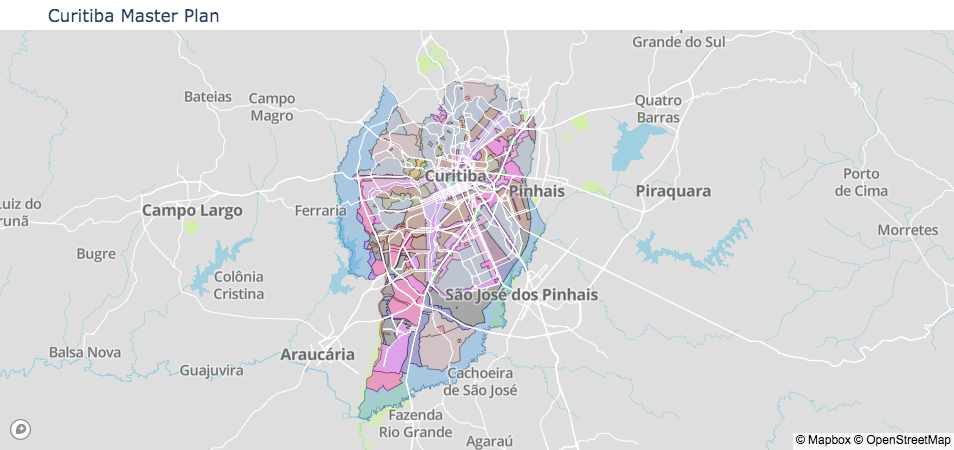

time: 19 s (started: 2021-06-08 01:23:36 -03:00)


In [3]:
fig_mp = px.choropleth_mapbox(df_mp, 
                           geojson=geo_mp, 
                           color="Zone",
                           locations="id",
                           featureidkey="properties.id",
                           hover_data=['Acronym', 'Name'],
                           zoom=9.5, center = {"lat": -25.486187, "lon": -49.250430},
                           opacity=0.3,
                           color_discrete_sequence=px.colors.qualitative.Dark24,
                           title="Curitiba Master Plan")
fig_mp.update_layout(mapbox_style="basic", mapbox_accesstoken=mapbox_token)
fig_mp.update_layout(title_y=1,margin={"r":0,"t":30,"l":0,"b":0},title_pad={"t":10})
fig_mp.update_layout(showlegend=False)
fig_mp.show()

## Neighbourhoods: ##

In [ ]:
geo_neigh = {"type": "FeatureCollection", "name": "ZONEAMENTO", "crs": { "type": "name", "properties": { "name": "urn:ogc:def:crs:OGC:1.3:CRS84" }}, 'features' : []}

sql_neigh = "SELECT a.id, a.neighbourhood AS 'Neighbourhood', a.sectional_name as 'Sector', ST_AsGeoJSON(a.geometry_simple) AS 'geo' \
            FROM project.geo_neighbourhood a \
            ORDER BY a.neighbourhood, a.sectional_name;"

cur.execute(sql_neigh)
temp_content = []
for record in cur:
    cell = {'properties':{}}
    properties = {}
    cell_df = {}
    cell['type'] = "Feature"
    cell['id'] = record['id']
    properties['id'] = record['id']
    properties['Neighbourhood'] = record['Neighbourhood']
    properties['Borough'] = record['Sector']
    
    cell_df['id'] = record['id']
    cell_df['Neighbourhood'] = record['Neighbourhood']
    cell_df['Sector'] = record['Sector']

    cell['geometry'] = json.loads(record['geo'])
    cell['properties'].update(properties)
    geo_neigh['features'].append(cell)
    temp_content.append(cell_df)

df_neigh=pd.DataFrame(temp_content)
db.commit()

In [ ]:
fig_neigh = px.choropleth_mapbox(df_neigh, 
                           geojson=geo_neigh, 
                           color="Neighbourhood",
                           locations="id",
                           featureidkey="properties.id",
                           hover_data=['Sector'],
                           zoom=9.5, center = {"lat": -25.486187, "lon": -49.250430},
                           opacity=0.3,
                           color_discrete_sequence=px.colors.qualitative.Dark24,
                           title="Curitiba Neighbourhoods")
fig_neigh.update_layout(mapbox_style="basic", mapbox_accesstoken=mapbox_token)
fig_neigh.update_layout(title_y=1,margin={"r":0,"t":30,"l":0,"b":0},title_pad={"t":10})
fig_neigh.update_layout(showlegend=False)
fig_neigh.show()

## Definindo os pontos para coleta: ##

Para a coleta dos pontos de interesse em Curitiba, vamos trabalhar com a região em um raio de 7km no entorno bairro Batel.

In [2]:
def get_coordinates(api_key, address, verbose=False):
    try:
        url = 'https://maps.googleapis.com/maps/api/geocode/json?key={}&address={}'.format(api_key, address)
        response = requests.get(url).json()
        if verbose:
            print('Google Maps API JSON result =>', response)
        results = response['results']
        geographical_data = results[0]['geometry']['location'] # get geographical coordinates
        lat = geographical_data['lat']
        lon = geographical_data['lng']
        return [lat, lon]
    except:
        return [None, None]

verbose = True
address = 'Fanny, Curitiba - PR, Brasil'
curitiba_center = get_coordinates(gmaps_token, address)
print('Coordinate of {}: {}'.format(address, curitiba_center))

Coordinate of Fanny, Curitiba - PR, Brasil: [-25.4833853, -49.27074409999999]
time: 625 ms (started: 2021-06-07 00:03:12 -03:00)


In [3]:
def calc_points(azimuth_step, radius, lat, long):
    lat = math.radians(lat)
    long = math.radians(long)
    temp_content=[]
    azimuth = 0
    while azimuth < 360:
        point = {}
        tc = math.radians(azimuth)
        temp_lat = math.degrees(math.asin(math.sin(lat)*math.cos(radius) + math.cos(lat)*math.sin(radius)*math.cos(tc)))
        if math.cos(long) == 0 :
            temp_lon = math.degrees(curitiba_long)
        else:
            temp_lon = math.degrees(((long + math.asin(math.sin(tc)*math.sin(radius) / math.cos(lat)) + math.pi) % (2*math.pi)) - math.pi)
        point['lat'] = round(temp_lat, 6)
        point['long'] = round(temp_lon, 6)
        point['distance'] = None
        point['valid'] = None
        point['checked'] = False
        temp_content.append(point)
        azimuth += azimuth_step
    return temp_content

def point_is_in_curitiba(lat, long):
    query = "SELECT count(a.id) as num FROM project.geo_neighbourhood a \
            WHERE ST_CONTAINS(a.geometry, ST_PointFromText('POINT(%s %s)', 4326));"
    cur.execute(query, (round(lat, 6), round(long, 6)))
    result = cur.fetchone()
    return result['num']

curitiba_lat = round(curitiba_center[0], 6)
curitiba_long = round(curitiba_center[1], 6)

azimuth_step = 60 
hexagon_apothem = 1 # km
radius = 2*hexagon_apothem/distance.EARTH_RADIUS
max_radius = 20 # km

df_search_points = ""
# First try to read parquet file
try:
    df_search_points = pd.read_parquet('./parquet/points.parquet', engine='fastparquet')
    print("Parquet file readed.")
except:
    # Create a list of points:

    final_list=[]
    # Add start point to list

    point = {}
    point['lat'] = curitiba_lat
    point['long'] = curitiba_long
    point['distance'] = 0
    point['valid'] = True
    point['checked'] = True
    final_list.append(point)

    main_point = (curitiba_lat, curitiba_long)
    temp_list = calc_points(azimuth_step, radius, curitiba_lat, curitiba_long)
    final_list.extend(temp_list)
    new_item = True
    while new_item == True:
        new_item = False
        temp_list = []
        for line in final_list:
            if line['checked'] != True:
                point = (line['lat'], line['long'])
                dist = distance.great_circle(main_point, point).km
                if dist > max_radius:
                    line['checked'] = True
                    line['distance'] = dist
                    line['valid'] = False
                else:
                    line['valid'] = True
                    line['reason'] = point_is_in_curitiba(line['lat'], line['long'])
                    # check if point is also on list
                    for linecheck in final_list:
                        #print('{} and {} and {}'.format(abs(linecheck['lat'] - line['lat']), abs(linecheck['long'] - line['long']), linecheck['checked']))
                        if abs(linecheck['lat'] - line['lat']) < 0.0001 and abs(linecheck['long'] - line['long']) < 0.0001 and linecheck['checked'] == True:
                            line['valid'] = False
                            break
                    
                    # Check if point is in Curitiba (using MySQL)
                    if line['valid'] == True and point_is_in_curitiba(line['lat'], line['long']) == 0:
                        line['valid'] = False
                    line['checked'] = True
                    line['distance'] = dist
                    if line['valid'] == True:
                        new_item = True
                        temp_list.extend(calc_points(azimuth_step, radius, line['lat'], line['long']))
        if new_item == True:
            final_list.extend(temp_list)
    final_list[:] = [x for x in final_list if x['valid'] == True]
    df_search_points = pd.DataFrame(final_list)
    df_search_points.to_parquet('./parquet/points.parquet')
    print("Parquet file saved.")
print('Dataframe have {} points.'.format(df_search_points.shape[0]))

Parquet file readed.
Dataframe have 129 points.
time: 563 ms (started: 2021-06-07 00:03:14 -03:00)


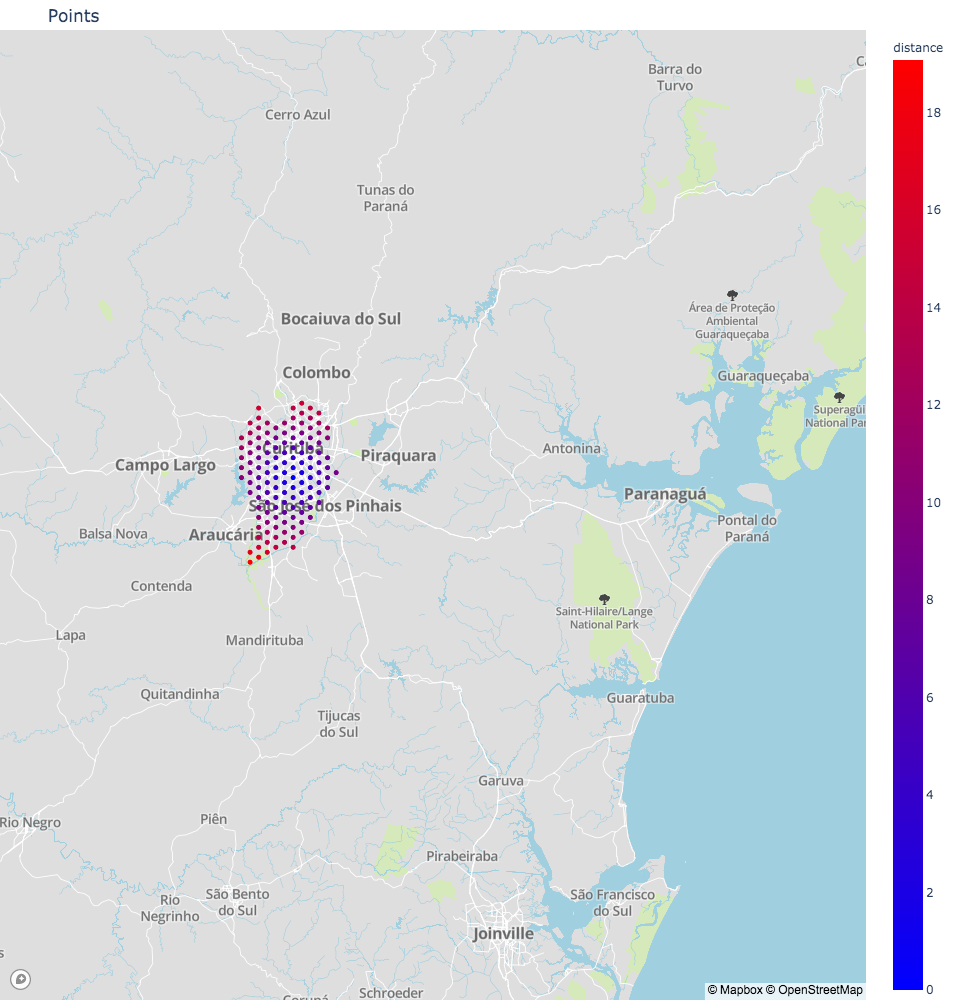

time: 313 ms (started: 2021-06-04 23:58:12 -03:00)


In [63]:
fig_points = px.scatter_mapbox(df_search_points, lat="lat", lon="long", hover_data=["distance", "reason"],
                        color="distance",
                        zoom=9.8, center = {"lat": curitiba_lat, "lon": curitiba_long},
                        color_continuous_scale=px.colors.sequential.Bluered,
                        height=500,
                        title="Points")
fig_points.update_layout(mapbox_style="basic", mapbox_accesstoken=mapbox_token)
fig_points.update_layout(title_y=1,margin={"r":0,"t":30,"l":0,"b":0},title_pad={"t":10})
fig_points.update_layout(showlegend=False)
fig_points.show()

In [4]:
def get_venues_near(index, lat, lon, category, interest_category, client_id, client_secret, version, radius=1000, limit=100):
    url = 'https://api.foursquare.com/v2/venues/explore?client_id={}&client_secret={}&v={}&ll={},{}&categoryId={}&radius={}&limit={}&locale=en'.format(client_id, client_secret, version, lat, lon, category, radius, limit)
    all_json = requests.get(url).json()
    totalResults = all_json['response']['totalResults']
    if totalResults > 100:
        print('Point with more than 100 venues ({} venues).'.format(all_json['response']['totalResults']), end='')
    elif totalResults == 0:
        print('.', end='')
    else:
        results = all_json['response']['groups'][0]['items']
        for item in results:
            id_venue = item['venue']['id']
            check_nenue = venue_in_database(id_venue)
            name = item['venue']['name']
            lat = item['venue']['location']['lat']
            long = item['venue']['location']['lng']
            address = "" if dot_get(item['venue'], 'location.address') == None else dot_get(item['venue'], 'location.address')
            categories = get_categories(item['venue']['categories'])
            if check_nenue == False:
                print('N', end='')
                categories, tipCount, likes, tier, rating, verified = venue_detail(id_venue, categories, client_id, client_secret, version)
                sql_insert = 'INSERT INTO project.foursquare_venues (id, name, lat, `long`, geo_point, address, categories, tipCount, tier, rating, index_df, totalResults, likes, verified) \
                    SELECT * FROM (SELECT %s as id, %s as name, %s as lat, %s as `long`, ST_PointFromText(\'POINT(%s %s)\', 4326) as geo_point, \
                    %s as address, %s as categories, %s as tipCount, %s as tier, %s as rating, %s as index_df, %s, %s as likes, %s as verified) as tmp \
                    WHERE NOT EXISTS (SELECT id FROM project.foursquare_venues WHERE id = %s) LIMIT 1;'
                cur.execute(sql_insert, (id_venue, name, lat, long, long, lat, address, categories, tipCount, tier, rating, index, totalResults, likes, verified, id_venue))
            elif check_nenue == 'detail':
                print('D', end='')
                categories, tipCount, likes, tier, rating, verified = venue_detail(id_venue, categories, client_id, client_secret, version)
                sql_update = "UPDATE project.foursquare_venues set (categories = {}, tipCount = {}, likes = {}, tier = {}, rating = {}, verified = {}) WHERE id = {};"
                cur.execute(sql_insert, (categories, tipCount, likes, tier, rating, verified, id_venue))
            
        print('.', end='')
        db.commit()

def get_categories(categories):
    return json.dumps([(cat['name'], cat['id']) for cat in categories])

def dot_get(dictionary, dot_path, default=None):
    path = dot_path.split('.')
    try:
        return reduce(dict.__getitem__, path, dictionary)
    except KeyError:
        return default
    except TypeError:
        return default

def venue_detail(id_venue, categories, client_id, client_secret, version):
    url_venue = 'https://api.foursquare.com/v2/venues/{}?client_id={}&client_secret={}&v={}&locale=en'.format(id_venue,client_id, client_secret, version)
    venue_detail = requests.get(url_venue).json()
    venue = dot_get(venue_detail, 'response.venue')
    if venue == None:
        categories = categories
        tipCount = None
        likes = None
        tier = None
        rating = None
        verified = None
    else:
        categories = get_categories(venue['categories'])
        tipCount = 0 if dot_get(venue, 'stats.tipCount') == None else dot_get(venue, 'stats.tipCount')
        likes =  0 if dot_get(venue, 'likes.count') == None else dot_get(venue, 'likes.count')
        tier = 0 if dot_get(venue, 'price.tier') == None else dot_get(venue, 'price.tier')
        rating = 0 if dot_get(venue, 'rating') == None else dot_get(venue, 'rating')
        verified = 1 if venue['verified'] == True else 0
    return categories, tipCount, likes, tier, rating, verified

def venue_in_database(id_venue):
    query = "SELECT count(id) as id, tipCount FROM project.foursquare_venues a WHERE id = '" + id_venue + "';"
    cur.execute(query)
    result = cur.fetchone()
    if result['id'] == 0:
        return False
    elif result['tipCount'] == None:
        return 'detail'
    else:
        return 'Ok'
    
# Given the hexagon apothem, calc his radius.
hexagon_radius = math.sqrt(4*hexagon_apothem**2/3)*1010 # in meters plus 1%

base_category = '4bf58dd8d48988d16a941735' # Food category 
interest_category = set(['4bf58dd8d48988d16a941735', '4bf58dd8d48988d179941735', '4bf58dd8d48988d1d0941735','4bf58dd8d48988d1f5941735', '4bf58dd8d48988d16d941735', '4bf58dd8d48988d128941735'])
x = 1
for index, row in df_search_points.iterrows():
    get_venues_near(index, row['lat'], row['long'], base_category, interest_category, foursquare['user_key'], foursquare['user_secret'], foursquare['version'], hexagon_radius, 100)
    if x > 140:
        # To prevent an infinite loop using out quota at FourSquare API
        break
    x += 1

.................................................................NNN.NN.NNNN...N..NN...NNN....N.NNNN.NNNNNNNNN.NNNNNN.NNN.NNNNNNNN.NNN.NNN.NNNNNN.NNNNNNN.NNNNNN.NN.....N.N...N..N.NNN.NNNNNN.NNNN.N.NNNNN.NNNNN.N.....N...N.N.N....NN........
time: 1min 57s (started: 2021-06-07 00:03:33 -03:00)


In [17]:
try:
    df_venues = pd.read_parquet('./parquet/venues.parquet', engine='fastparquet')
    print("Parquet file readed.")
except:
    df_venues = pd.read_sql('SELECT id, name, `lat`, `long`, address, categories, tipCount, tier, likes, rating, verified, ST_AsGeoJSON(geo_point) as geo_point, ST_AsGeoJSON(area) as area, index_df, totalResults FROM project.foursquare_venues', con=db)
    df_venues.to_parquet('./parquet/venues.parquet')

df_venues[['id', 'name', 'lat', 'long', 'address', 'categories', 'tipCount', 'tier', 'likes', 'rating']].head(10)

Parquet file readed.


,id,name,lat,long,address,categories,tipCount,tier,likes,rating
0,4b69efebf964a5201bbd2be3,Confeitaria das Famílias,-25.430643,-49.270212,"R. Quinze de Novembro, 374","[[""Dessert Shop"", ""4bf58dd8d48988d1d0941735""],...",114,1,235,6.7
1,4b75d4fcf964a520ee272ee3,Panetteria Maiochi,-25.472368,-49.288013,"R. Maranhão, 1730","[[""Bakery"", ""4bf58dd8d48988d16a941735""], [""Con...",22,1,34,6.3
2,4b7c57d1f964a5209f8d2fe3,La Patisserie,-25.442422,-49.279188,"Av. Sete de Setembro, 4194","[[""Bakery"", ""4bf58dd8d48988d16a941735""], [""Cof...",71,2,111,6.3
3,4b8abddbf964a520c07d32e3,Saint Germain,-25.432826,-49.290227,"Al. Prca. Izabel, 1347","[[""Bakery"", ""4bf58dd8d48988d16a941735""], [""Del...",57,3,221,6.9
4,4ba29a89f964a520680838e3,Saint Germain,-25.444152,-49.287664,"Av. Visc. de Guarapuava, 4882","[[""Bakery"", ""4bf58dd8d48988d16a941735""], [""Bre...",180,3,617,7.8
5,4ba53d22f964a5202bf038e3,Requinte,-25.412083,-49.253352,"R. Recife, 34","[[""Bakery"", ""4bf58dd8d48988d16a941735""], [""Bre...",163,3,525,8.0
6,4bad2568f964a52086323be3,Panificadora Verdes Mares,-25.422681,-49.256221,"R. Mauá, 28","[[""Bakery"", ""4bf58dd8d48988d16a941735""], [""Bra...",31,2,48,6.3
7,4bae12d6f964a5201f813be3,Provence Boulangerie,-25.444399,-49.289972,"R. Bruno Filgueira, 548","[[""Bakery"", ""4bf58dd8d48988d16a941735""], [""Caf...",56,3,76,6.5
8,4bb36e49a32876b028a901fe,Marcolini Alimentari,-25.435534,-49.286224,"Al. Dr. Carlos de Carvalho, 1181","[[""Bakery"", ""4bf58dd8d48988d16a941735""], [""Caf...",101,3,146,6.1
9,4bb3a3e1715eef3bd7a186bb,Rico Pão,-25.428397,-49.262645,Av. Mal. Deodoro da Fonseca,"[[""Bakery"", ""4bf58dd8d48988d16a941735""]]",68,2,110,5.6


time: 94 ms (started: 2021-06-07 00:30:17 -03:00)


## Coletando dados do Foursquare ##
Lista dos estabelecimentos de interesse:
* Food: 4d4b7105d754a06374d81259
  * Pizza Place: 4bf58dd8d48988d1ca941735
  * Bakery: 4bf58dd8d48988d16a941735
    * Bagel Shop: 4bf58dd8d48988d179941735
    * Dessert Shop: 4bf58dd8d48988d1d0941735
    * Gourmet Shop: 4bf58dd8d48988d1f5941735
    * Café: 4bf58dd8d48988d16d941735
    * Cafeteria: 4bf58dd8d48988d128941735

From Wikipedia (https://pt.wikipedia.org/wiki/Lista_de_bairros_de_Curitiba) we are scrapping the Socioeconimic data of neighborhoods of Curitiba. These data will be inserted at the MySQL. Scripts can be found at GitHub too (https://github.com/ftauscheck/The-Battle-of-the-Neighborhoods/blob/main/support/neighbour_wiki.py).


Another source of information will be the FourSquare API, where we 
** 

We decided to use regularly spaced grid of locations, centered around city center, to define our neighborhoods.

Following data sources will be needed to extract/generate the required information:

centers of candidate areas will be generated algorithmically and approximate addresses of centers of those areas will be obtained using Google Maps API reverse geocoding
number of restaurants and their type and location in every neighborhood will be obtained using Foursquare API
coordinate of Berlin center will be obtained using Google Maps API geocoding of well known Berlin location (Alexanderplatz)

Para nossa análise utilizaremos dados do IPPUC **Instituto de Pesquisa e Planejamento Urbano de Curitiba** (Institute of Urban Planning and Research of Curitiba also know as IPPUC) sobre o Plano Diretor de Curitiba e principais vias da cidade, junto com os dados do Foursquare (obtidos através de requisições via API).





 O Plano Diretor de Curitiba divide a área do município em Zonas, com regras claras sobre ocupação do solo, altura das edificações e possibilidade (ou não) de comércio ou indústrias no local. Na imagem abaixo (Google Earth) podemos ver o Plano Diretor aplicado. Em vermelho temos Avenidas com grande capacidade. Em laranja uma via dedicada ao transporte público e serviços. No entorno desta via é possível a instalação de prédios mais altos e serviços, enquanto que duas quadras para o lado não temos mais prédios altos.

![title](img/GE_zones.png)

We will use our data science powers to generate a few most promissing neighborhoods based on this criteria. Advantages of each area will then be clearly expressed so that best possible final location can be chosen by stakeholders.

In [ ]:
import configparser
config = configparser.ConfigParser()
config.read('config.ini')
print(config.sections())
config['database']['host']

for key in config['database']:  
    print(key)
    

In [83]:
def fun(y):
    for x in range(0, 4):
        y = x
    str = "Teste"
    return str, y;
  
# Driver code to test above method

str, x = fun(5) # Assign returned tuple
print(str)
print(x)
str = "Teste2"
x = 2
print(str)
print(x)

Teste
3
Teste2
2
time: 0 ns (started: 2021-06-05 23:53:19 -03:00)
